<a href="https://colab.research.google.com/github/JaganK2Commit/Copilot/blob/main/BedTimeStory_V3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### What should be the video be about ?


In [1]:
NARRATOR_ADJECTIVES = "story teller"
MUSIC_STYLE = "kids friendly random music"

## Tools and Models used in this notebook

Tools and models used in this script

| Task                | Service         | Model              |
|---------------------|-----------------|--------------------|
| Script generation   | OpenAI API      | gpt-3.5-turbo      |
| Text to Image       | Replicate AI API| ai-forever/kandinsky-2 |
| Text to Audio       | Replicate AI API| suno-ai/bark |
| Text to Audio       | Resemble AI API| - |


### Install the dependencies

In [2]:
!pip install replicate
!pip install requests
!pip install openai
!pip install langchain
!pip install moviepy
!pip install ffmpeg --upgrade
!pip install pydub
!pip install resemble
from google.colab import output
output.clear()

In [3]:
import os
import openai
import time
import numpy as np
import replicate
import json

In [4]:
from langchain.prompts import PromptTemplate
from langchain.chains import LLMChain, SimpleSequentialChain, SequentialChain, TransformChain
from langchain.llms import OpenAI, Replicate
from langchain.chat_models import ChatOpenAI
from langchain.prompts.chat import (
    ChatPromptTemplate,
    SystemMessagePromptTemplate,
    AIMessagePromptTemplate,
    HumanMessagePromptTemplate,
)
from langchain.schema import (
    AIMessage,
    HumanMessage,
    SystemMessage
)
from pydub import AudioSegment

## Aquire Tokens for Replicate and OpenAI

In [5]:
# get your token from https://replicate.com/account
from getpass import getpass

REPLICATE_API_TOKEN = getpass()
os.environ["REPLICATE_API_TOKEN"] = REPLICATE_API_TOKEN

··········


In [6]:
# get your key from https://platform.openai.com/account/api-keys
OPENAI_API_KEY = getpass()
os.environ["OPENAI_API_KEY"] = OPENAI_API_KEY
openai.api_key = os.getenv("OPENAI_API_KEY")

··········


In [7]:
# get your key from https://app.resemble.ai/account/api
from resemble import Resemble

RESEMBLE_API_KEY = getpass()
os.environ["RESEMEBLE_API_KEY"] = RESEMBLE_API_KEY
Resemble.api_key(os.environ['RESEMEBLE_API_KEY'])

··········


## Create the LongChain

In [93]:
# LLMChain to write a a script for our how-to video.
topic_template = """
Generate a script for a short moral story for children of 5 to 7 years old. Avoid people in the story.
Write the story in JSON format with the following keys:

{{
"title": Title for the story, not exceeding 15 words
"description":compose a description for the story, not exceeding 50 words
"story_lines" :
[{{
  "paragraphs": A paragraph that make up the story, not exceeding 30 words,
  "scene_description" : visual descriptions corresponding to each paragraph, so that this allow AI image tools to generate appropriate picture,
  "character_descriptions" : [{{
    "name" : Name of the character in this paragraph, name contain no adjectives,
    "description": appearance of the character, so that it allows to generate appropriate picture
  }}]
}}]

story_lines: Should contain minimum 10 story lines.
Story should not include more than 2 characters.
Validate the output to be of json format, please include comma if it is being missed

Thank you!
"""
system_message_prompt = SystemMessage(content="You are a story teller, shares wide range of fairy tales, bedtime stories, kids stories, and be creative in your responses")
human_message_prompt = HumanMessagePromptTemplate(prompt=PromptTemplate(
                                                  template=topic_template,
                                                  input_variables=[]
                                                  ))

# create the initial script
chat = ChatOpenAI(temperature=0.7, model_name="gpt-3.5-turbo")
chat_prompt_template = ChatPromptTemplate.from_messages([human_message_prompt])
script_chain = LLMChain(llm=chat, prompt=chat_prompt_template, output_key='script')

script = script_chain.run({"narrator_adjectives": NARRATOR_ADJECTIVES, "music_style": MUSIC_STYLE})
# data = json.loads(result)
# script = data['paragraphs']
# video_descriptions = data['video_descriptions']
print(script)
# print(chat_prompt_template)
# print(video_descriptions)

{
  "title": "The Lost Kite",
  "description": "A story about a little girl who learns the importance of honesty and responsibility.",
  "story_lines": [
    {
      "paragraphs": "Lucy loved flying her kite in the park every day.",
      "scene_description": "Lucy running in the park with her colorful kite in hand.",
      "character_descriptions": [
        {
          "name": "Lucy",
          "description": "A happy little girl with blonde hair and a big smile."
        }
      ]
    },
    {
      "paragraphs": "One day, a strong gust of wind carried her kite away.",
      "scene_description": "Lucy holding onto the kite string, trying to prevent it from flying away.",
      "character_descriptions": [
        {
          "name": "Lucy",
          "description": "A worried little girl with her arm stretched out, desperately holding onto the kite string."
        }
      ]
    },
    {
      "paragraphs": "Lucy chased after the kite, but it landed in a tree.",
      "scene_descript

In [125]:
script =  """
{
  "title": "The Steady Tortoise and the Swift Hare",
  "description": "A story about a steady Tortoise and a swift Hare, teaching the values of consistency and humility.",
  "story_lines": [
    {
      "paragraphs": "In a lush green meadow, a steady Tortoise lived peacefully.",
      "scene_description": "A lush green meadow with a tortoise slowly moving.",
      "character_descriptions": [
        {
          "name": "Tortoise",
          "description": "A steady, old tortoise with a hard shell and gentle eyes."
        }
      ]
    },
    {
      "paragraphs": "Nearby, a swift Hare, known for his speed, resided.",
      "scene_description": "A swift hare hopping around energetically in the meadow.",
      "character_descriptions": [
        {
          "name": "Hare",
          "description": "A swift, energetic hare with soft fur and bright, eager eyes."
        }
      ]
    },
    {
      "paragraphs": "The Hare often mocked the Tortoise for his slow pace.",
      "scene_description": "The hare teasing the tortoise, looking playful and a bit arrogant.",
      "character_descriptions": []
    },
    {
      "paragraphs": "The Tortoise, however, never let the Hare's words bother him.",
      "scene_description": "The tortoise moving steadily, looking calm and unaffected.",
      "character_descriptions": []
    },
    {
      "paragraphs": "One day, the Tortoise proposed a race to the Hare.",
      "scene_description": "The tortoise proposing a race to the hare, looking determined.",
      "character_descriptions": []
    },
    {
      "paragraphs": "The Hare, confident of his speed, accepted the challenge.",
      "scene_description": "The hare accepting the challenge, looking confident and eager.",
      "character_descriptions": []
    },
    {
      "paragraphs": "The race began, and the Hare sprinted ahead.",
      "scene_description": "The hare sprinting ahead, the tortoise moving steadily.",
      "character_descriptions": []
    },
    {
      "paragraphs": "Seeing the Tortoise far behind, the Hare decided to rest.",
      "scene_description": "The hare resting under a tree, looking relaxed and confident.",
      "character_descriptions": []
    },
    {
      "paragraphs": "The Tortoise, however, continued his steady pace, undeterred.",
      "scene_description": "The tortoise moving steadily, looking focused and determined.",
      "character_descriptions": []
    },
    {
      "paragraphs": "Hours passed, and the Hare woke up from his nap.",
      "scene_description": "The hare waking up, looking surprised and worried.",
      "character_descriptions": []
    },
    {
      "paragraphs": "To his shock, he saw the Tortoise nearing the finish line.",
      "scene_description": "The hare looking shocked, the tortoise nearing the finish line.",
      "character_descriptions": []
    },
    {
      "paragraphs": "The Hare sprinted with all his might, but it was too late.",
      "scene_description": "The hare sprinting towards the finish line, looking desperate.",
      "character_descriptions": []
    },
    {
      "paragraphs": "The Tortoise had crossed the finish line, winning the race.",
      "scene_description": "The tortoise crossing the finish line, looking calm and victorious.",
      "character_descriptions": []
    },
    {
      "paragraphs": "The Hare realized his mistake and apologized to the Tortoise.",
      "scene_description": "The hare apologizing to the tortoise, looking humble and regretful.",
      "character_descriptions": []
    },
    {
      "paragraphs": "The story teaches us the value of consistency, humility, and the folly of underestimating others.",
      "scene_description": "The tortoise and the hare in the meadow, the hare looking humble, the tortoise looking wise.",
      "character_descriptions": []
    }
  ]
}

"""


## Script Scrubbing

In [126]:
## Fill the characters_descriptions with the last known description for each paragraph

def fill_character_descriptions(input_data):
    character_descriptions = {}

    for item in input_data["story_lines"]:
        current_character_descriptions = item.get("character_descriptions", [])
        for character_description in current_character_descriptions:
            character_name = character_description["name"]
            character_description_text = character_description.get("description", '')
            if(character_description_text != ''):
              character_descriptions[character_name] = character_description_text

    for item in input_data["story_lines"]:
        updated_character_descriptions = []
        current_character_descriptions = item.get("character_descriptions", [])
        for character_description in current_character_descriptions:
            character_name = character_description["name"]
            if character_name in character_descriptions:
                updated_character_description = {
                    "name": character_name,
                    "description": character_descriptions[character_name]
                }
                updated_character_descriptions.append(updated_character_description)
        item["character_descriptions"] = updated_character_descriptions

    return input_data


# Fill the character_descriptions with the last defined value
script = fill_character_descriptions(json.loads(script))

# Print the result
# for item in filled_input_data['story_lines']:
#   print(item.get("scene_description", []))

In [127]:
# LLMChain to write a title for our video
llm = OpenAI(temperature=.9)
template = """Please come up with a creative and zany title for the below how-to video script.
Puns are encouraged. Don't include quotations (") in the output.

Script:
{script}
Title: """
prompt_template = PromptTemplate(input_variables=["script"], template=template)
title_chain = LLMChain(llm=llm, prompt=prompt_template, output_key='title')

# title = title_chain.run({"script": script})
# print(title)



In [128]:
# LLMChain to create the replicate predictions for our text-to-image model
import re

previous_character_descriptions = {};

def update_scene_descriptions(input_data):
    character_descriptions = input_data["character_descriptions"]
    updated_scene_description = input_data["scene_description"]

    updated_scene_descriptions = []

    if character_descriptions:
        for character_description in character_descriptions:
            character_name = character_description["name"]
            character_description_text = character_description["description"]
            previous_character_descriptions[character_name] = character_description_text


    # Check if the character name appears in the scene description
    for character_name, character_description_text in previous_character_descriptions.items():
        # Append the character description to the scene description
        updated_scene_description = re.sub(re.escape(character_name), character_name + "," + character_description_text, updated_scene_description, flags=re.IGNORECASE)

    updated_scene_descriptions.append(updated_scene_description)

    return updated_scene_descriptions


def transform_func(inputs: dict) -> dict:
  video_model = replicate.models.get('ai-forever/kandinsky-2')
  video_version = video_model.versions.get("601eea49d49003e6ea75a11527209c4f510a93e2112c969d548fbb45b9c4f19f")
  descriptions = inputs['script']['story_lines']

  predictions = []

  for index,description in enumerate(descriptions):
      print(description)
      updated_description = update_scene_descriptions(description)[0]
      script['story_lines'][index]['scene_description'] = updated_description
      print(f"Creating video prediction for '{updated_description}'...")
      video_prediction = replicate.predictions.create(version=video_version,
                                                      input={"prompt": updated_description, "prior_steps": '5', "guidance_scale": 4, "num_inference_steps": 100, "prior_cf_scale":4,
                                                             "scheduler": "p_sampler", "width": 1024, "height":768})
      predictions.append(video_prediction)
  return {'video_predictions': predictions}

video_predictions_chain = TransformChain(input_variables=['script'], output_variables=['video_predictions'], transform=transform_func)

# video_predictions = video_predictions_chain.run({"script": script})
# print(video_predictions)

In [129]:
# LLMChain to create the replicate predictions for our bark model
def transform_func(inputs: dict) -> dict:
  audio_model = replicate.models.get("suno-ai/bark")
  audio_version = audio_model.versions.get("b76242b40d67c76ab6742e987628a2a9ac019e11d56ab96c4e91ce03b79b2787")
  parsed_script = inputs['script']['paragraphs']

  predictions = []

  for line in parsed_script:
      print(f"Creating audio prediction for '{line}''...")
      audio_prediction = replicate.predictions.create(version=audio_version,
                                                      input={"prompt": line, "history_prompt": "announcer", "text_temp": 0.7, "waveform_temp":0.8})
      predictions.append(audio_prediction)
  return {'audio_predictions': predictions}

audio_predictions_chain = TransformChain(input_variables=['script'], output_variables=['audio_predictions'], transform=transform_func)

In [130]:
# LLMChain to create the replicate predictions for our bark model
def transform_func(inputs: dict) -> dict:
  audio_model = replicate.models.get("suno-ai/bark")
  audio_version = audio_model.versions.get("b76242b40d67c76ab6742e987628a2a9ac019e11d56ab96c4e91ce03b79b2787")
  parsed_script = inputs['script']['paragraphs']

  predictions = []

  for line in parsed_script:
      print(f"Creating audio prediction for '{line}''...")
      audio_prediction = replicate.predictions.create(version=audio_version,
                                                      input={"prompt": line, "history_prompt": "announcer", "text_temp": 0.7, "waveform_temp":0.8})
      predictions.append(audio_prediction)
  return {'audio_predictions': predictions}

audio_predictions_chain = TransformChain(input_variables=['script'], output_variables=['audio_predictions'], transform=transform_func)

# audio_predictions = audio_predictions_chain.run({"script": script})
# print(audio_predictions)

In [131]:
# LLMChain to create the cover image
llm = OpenAI(temperature=.9)
template = """
          Create a visual description artstation, hd, dramatic lighting, detailed for the following script.
          "{script}""
          """
prompt_template = PromptTemplate(input_variables=["script"], template=template)

text2image = Replicate(model="ai-forever/kandinsky-2:601eea49d49003e6ea75a11527209c4f510a93e2112c969d548fbb45b9c4f19f",
                       input={"prior_steps": '5', "guidance_scale": 4, "num_inference_steps": 100, "prior_cf_scale":4,
                                                        "scheduler": "p_sampler"})

# text2image = Replicate(model="stability-ai/stable-diffusion:db21e45d3f7023abc2a46ee38a23973f6dce16bb082a930b0c49861f96d1e5bf",
#                        input={'image_dimensions': '512x512', "negative_prompt": "text, writing"})
title_image_chain = LLMChain(llm=text2image, prompt=prompt_template, output_key='title_image')

# title_image = title_image_chain.run({"script": script})
# print(title_image)

In [132]:
# LLMChain to write the thank you note at the end of our video
template = """Please come up with a creative and zany ending quote from our narrator.
The script is what the narrator just read. We want to close things out in less than 15 words.

Make sure you add a "Please like and subscribe for more such stories!" to the end of your output.

You are a {narrator_adjectives} narrator.

Script:
{script}
Ending quote:
"""

system_message_prompt = SystemMessage(content="You are a helpful assistant.")
human_message_prompt = HumanMessagePromptTemplate(prompt=PromptTemplate(
                                                  template=template,
                                                  input_variables=["script", "narrator_adjectives"]))
chat_prompt_template = ChatPromptTemplate.from_messages([system_message_prompt, human_message_prompt])
ending_quote_chain = LLMChain(llm=chat, prompt=chat_prompt_template, output_key='ending_quote')

# ending_quote = ending_quote_chain.run({"script": script, "narrator_adjectives": NARRATOR_ADJECTIVES})
# print(ending_quote)

In [133]:
# LLMChain to create the prediction that generates the audio for the thank you note
def transform_func(inputs: dict) -> dict:
  audio_model = replicate.models.get("suno-ai/bark")
  audio_version = audio_model.versions.get("b76242b40d67c76ab6742e987628a2a9ac019e11d56ab96c4e91ce03b79b2787")
  ending_quote_prediction = replicate.predictions.create(version=audio_version,
                                                      input={"prompt": inputs['ending_quote'], "history_prompt": "announcer", "text_temp": 0.7, "waveform_temp":0.8}) #en_speaker_6 female, loud
  return {'ending_quote_prediction': ending_quote_prediction}

ending_quote_prediction_chain = TransformChain(input_variables=['ending_quote'], output_variables=['ending_quote_prediction'], transform=transform_func)

# ending_quote_prediction = ending_quote_prediction_chain.run({"ending_quote": ending_quote})
# print(ending_quote_prediction)

#chain_output['ending_quote_prediction'].output['audio_out']


In [134]:
# LLMChain to create the prediction that generates the audio for the title
def transform_func(inputs: dict) -> dict:
  audio_model = replicate.models.get("suno-ai/bark")
  audio_version = audio_model.versions.get("b76242b40d67c76ab6742e987628a2a9ac019e11d56ab96c4e91ce03b79b2787")
  title_prediction = replicate.predictions.create(version=audio_version,
                                                      input={"prompt": inputs['title'],"history_prompt": "announcer", "text_temp": 0.7, "waveform_temp":0.8})
  return {'title_audio_prediction': title_prediction}

title_audio_prediction_chain = TransformChain(input_variables=['title'], output_variables=['title_audio_prediction'], transform=transform_func)

# title_audio_prediction = title_audio_prediction_chain.run({"title": title})
# print(title_audio_prediction)


In [135]:
# LLMChain to create the prediction that generates the background music
def transform_func(inputs: dict) -> dict:
  model = replicate.models.get("riffusion/riffusion")
  version = model.versions.get("8cf61ea6c56afd61d8f5b9ffd14d7c216c0a93844ce2d82ac1c9ecc9c7f24e05")
  music_prediction = replicate.predictions.create(version=version, input={"prompt": inputs['music_style']})

  return {'music_prediction': music_prediction}

music_prediction_chain = TransformChain(input_variables=['music_style'], output_variables=['music_prediction'], transform=transform_func)

music_prediction = music_prediction_chain.run({"music_style": MUSIC_STYLE})
print(music_prediction)

id='bwjchazb6j7abykhnp3ztpzvte' error=None input={'prompt': 'kids friendly random music'} logs='' output=None status='starting' version=Version(id='8cf61ea6c56afd61d8f5b9ffd14d7c216c0a93844ce2d82ac1c9ecc9c7f24e05', created_at=datetime.datetime(2022, 12, 16, 7, 48, 40, 890140, tzinfo=datetime.timezone.utc), cog_version='0.6.1', openapi_schema={'info': {'title': 'Cog', 'version': '0.1.0'}, 'paths': {'/': {'get': {'summary': 'Root', 'responses': {'200': {'content': {'application/json': {'schema': {}}}, 'description': 'Successful Response'}}, 'operationId': 'root__get'}}, '/predictions': {'post': {'summary': 'Predict', 'responses': {'200': {'content': {'application/json': {'schema': {'$ref': '#/components/schemas/PredictionResponse'}}}, 'description': 'Successful Response'}, '422': {'content': {'application/json': {'schema': {'$ref': '#/components/schemas/HTTPValidationError'}}}, 'description': 'Validation Error'}}, 'description': 'Run a single prediction on the model', 'operationId': 'pre

## Run the chain

Now, let's execute the chain we created. This is relatively fast, because the chains that create long-running predictions (like the video_predictions_chain) make asynchronous calls to the Replicate API.

In [136]:
# Run the chain
overall_chain = SequentialChain(chains=[
    #script_chain,
                                        title_chain,
                                        video_predictions_chain,
                                        ending_quote_chain,
                                        ending_quote_prediction_chain,
                                        title_image_chain,
                                        title_audio_prediction_chain,
                                        music_prediction_chain
                                        ], input_variables=['script', 'narrator_adjectives', 'music_style'], output_variables=[
                                            #'script',
                                            'title', 'video_predictions', 'ending_quote', 'title_image', 'ending_quote_prediction', 'title_audio_prediction', 'music_prediction'], verbose=True)
chain_output = overall_chain({"script":script, "narrator_adjectives": NARRATOR_ADJECTIVES, "music_style": MUSIC_STYLE})



> Entering new  chain...
{'paragraphs': 'In a lush green meadow, a steady Tortoise lived peacefully.', 'scene_description': 'A lush green meadow with a tortoise slowly moving.', 'character_descriptions': [{'name': 'Tortoise', 'description': 'A steady, old tortoise with a hard shell and gentle eyes.'}]}
Creating video prediction for 'A lush green meadow with a Tortoise,A steady, old tortoise with a hard shell and gentle eyes. slowly moving.'...
{'paragraphs': 'Nearby, a swift Hare, known for his speed, resided.', 'scene_description': 'A swift hare hopping around energetically in the meadow.', 'character_descriptions': [{'name': 'Hare', 'description': 'A swift, energetic hare with soft fur and bright, eager eyes.'}]}
Creating video prediction for 'A swift Hare,A swift, energetic hare with soft fur and bright, eager eyes. hopping around energetically in the meadow.'...
{'paragraphs': 'The Hare often mocked the Tortoise for his slow pace.', 'scene_description': 'The hare teasing the tort

In [137]:
# unpack outputs
script = chain_output['script']
title = script['title']
split_script = script['story_lines']
video_descriptions = script['story_lines']
video_predictions = chain_output['video_predictions']
#audio_predictions = chain_output['audio_predictions']

# print(title)
print(len(split_script))
print(len(video_descriptions))
# print(video_predictions)
# print(audio_predictions)

video_predictions

15
15


[Prediction(id='r7efbebbiauowtwnrnc6cnvnri', error=None, input={'guidance_scale': 4, 'height': 768, 'num_inference_steps': 100, 'prior_cf_scale': 4, 'prior_steps': '5', 'prompt': 'A lush green meadow with a Tortoise,A steady, old tortoise with a hard shell and gentle eyes. slowly moving.', 'scheduler': 'p_sampler', 'width': 1024}, logs='', output=None, status='starting', version=Version(id='601eea49d49003e6ea75a11527209c4f510a93e2112c969d548fbb45b9c4f19f', created_at=datetime.datetime(2023, 4, 15, 12, 51, 14, 975476, tzinfo=datetime.timezone.utc), cog_version='0.6.1', openapi_schema={'info': {'title': 'Cog', 'version': '0.1.0'}, 'paths': {'/': {'get': {'summary': 'Root', 'responses': {'200': {'content': {'application/json': {'schema': {'title': 'Response Root  Get'}}}, 'description': 'Successful Response'}}, 'operationId': 'root__get'}}, '/predictions': {'post': {'summary': 'Predict', 'responses': {'200': {'content': {'application/json': {'schema': {'$ref': '#/components/schemas/Predic

In [138]:
# sanity check
assert len(split_script) == len(video_descriptions)

In [139]:
# response = Resemble.v2.voices.all(page, page_size)
# voice = list(filter(lambda x: x['name'] == 'Jagan-StoryNarrator', response['items']))[0]
# voice

# ⏳ Wait for our async predictions to complete
Here's a helper to check in on our predictions. This usually takes a minute or two.

In [140]:
def all_done(predictions):
    return set([p.status for p in predictions]) == {'succeeded'}

In [141]:
all_predictions = chain_output['video_predictions'] + \
                  [chain_output['ending_quote_prediction']] + \
                  [chain_output['title_audio_prediction']] + \
                  [chain_output['music_prediction']]

In [142]:
done = False

while not done:
  [p.reload() for p in all_predictions]
  for p in all_predictions:
    print(f'https://replicate.com/p/{p.id}', p.status)
  done = all_done(all_predictions)
  time.sleep(2)
  output.clear()

print("Predictions complete")


Predictions complete


# 🪡 Stitch them all together!

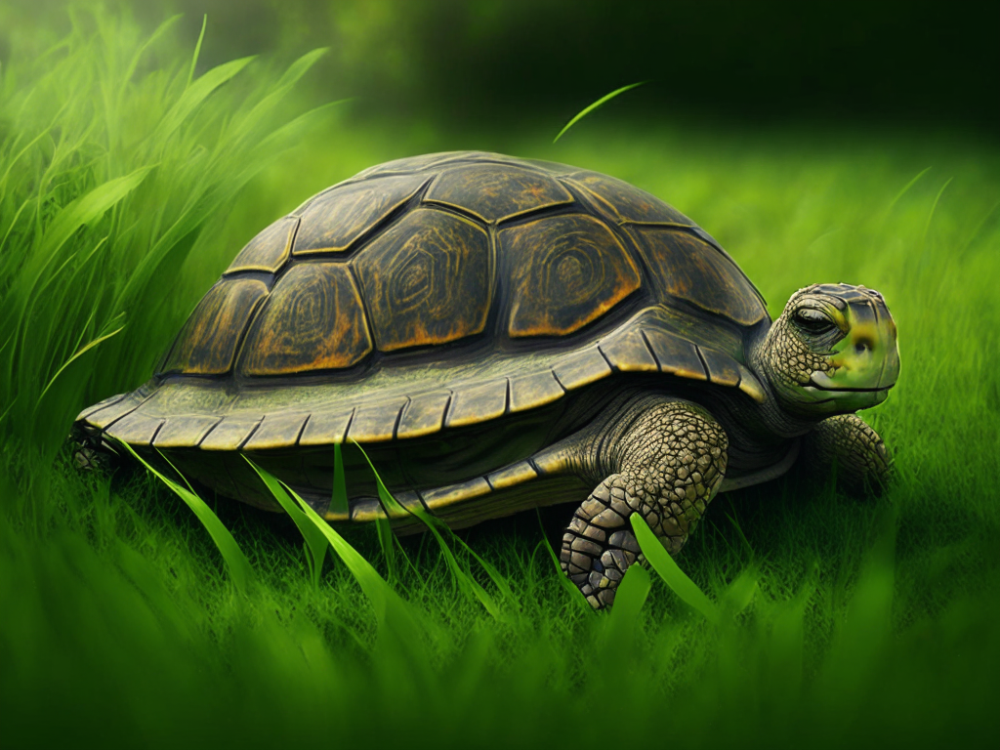

A lush green meadow with a Tortoise,A steady, old tortoise with a hard shell and gentle eyes. slowly moving.


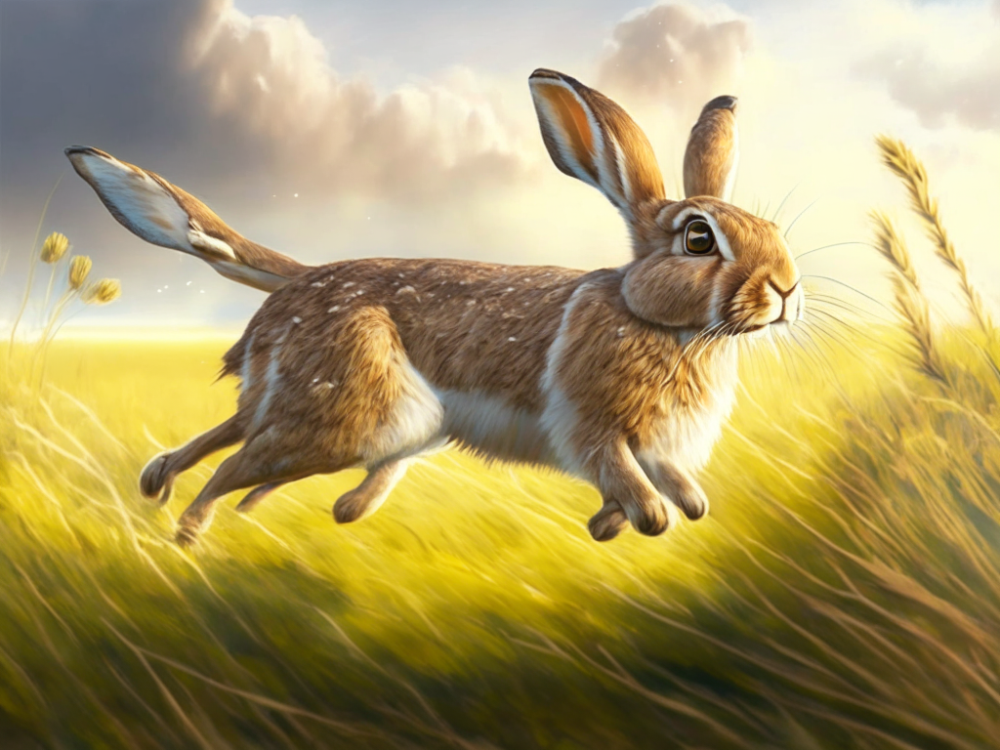

A swift Hare,A swift, energetic hare with soft fur and bright, eager eyes. hopping around energetically in the meadow.


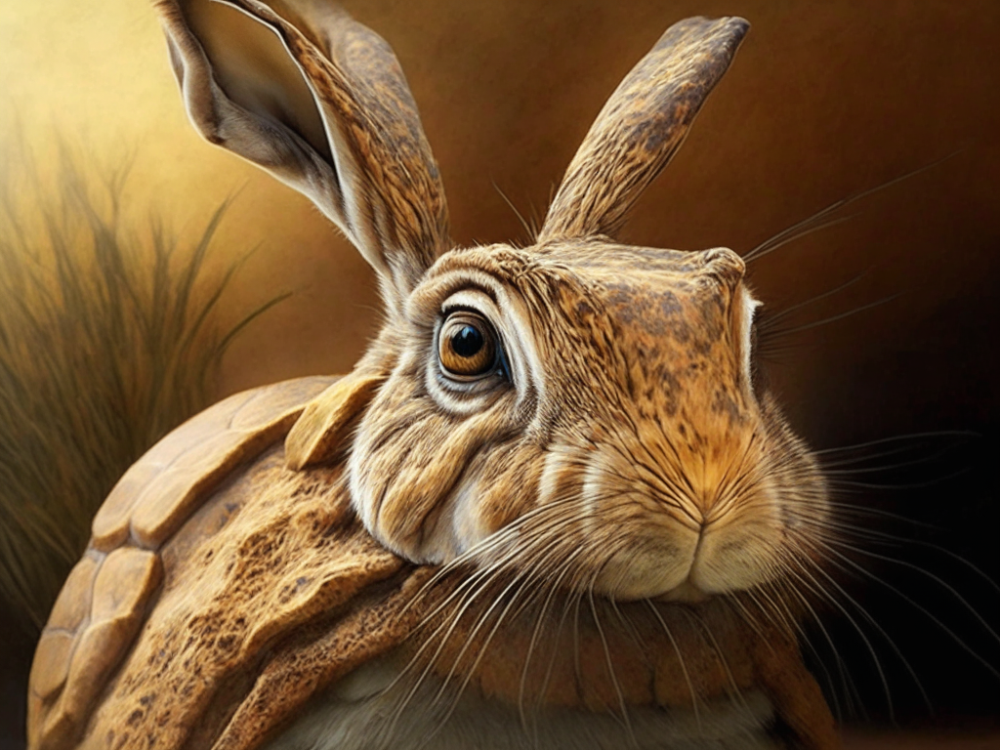

The Hare,A swift, energetic hare with soft fur and bright, eager eyes. teasing the Tortoise,A steady, old tortoise with a hard shell and gentle eyes., looking playful and a bit arrogant.


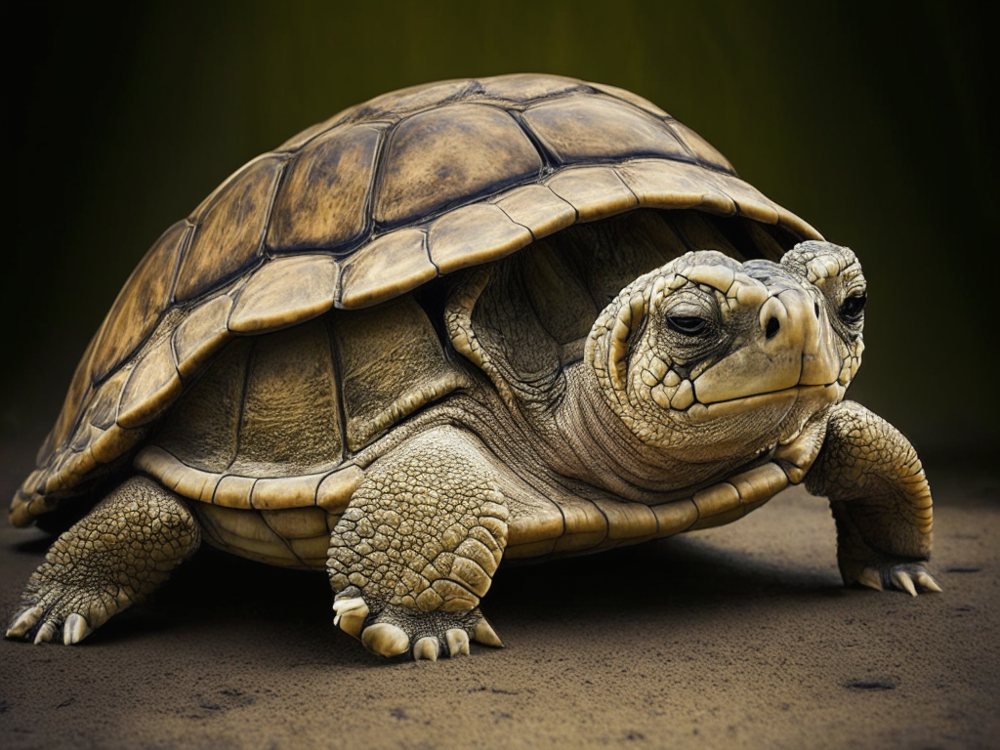

The Tortoise,A steady, old tortoise with a hard shell and gentle eyes. moving steadily, looking calm and unaffected.


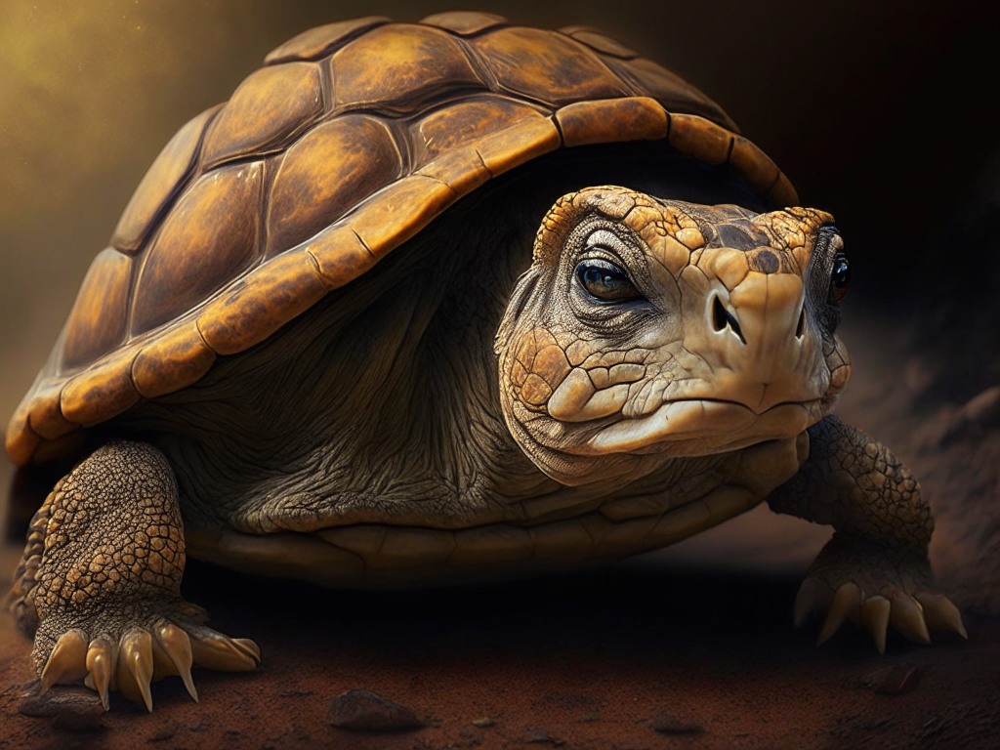

The Tortoise,A steady, old tortoise with a hard shell and gentle eyes. proposing a race to the Hare,A swift, energetic hare with soft fur and bright, eager eyes., looking determined.


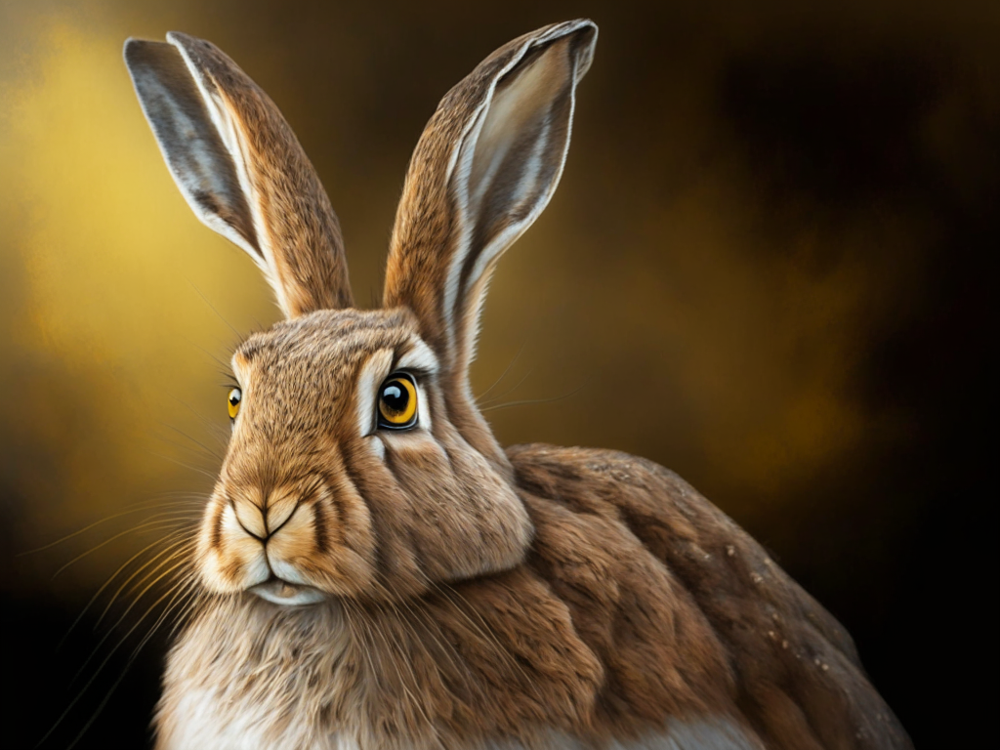

The Hare,A swift, energetic hare with soft fur and bright, eager eyes. accepting the challenge, looking confident and eager.


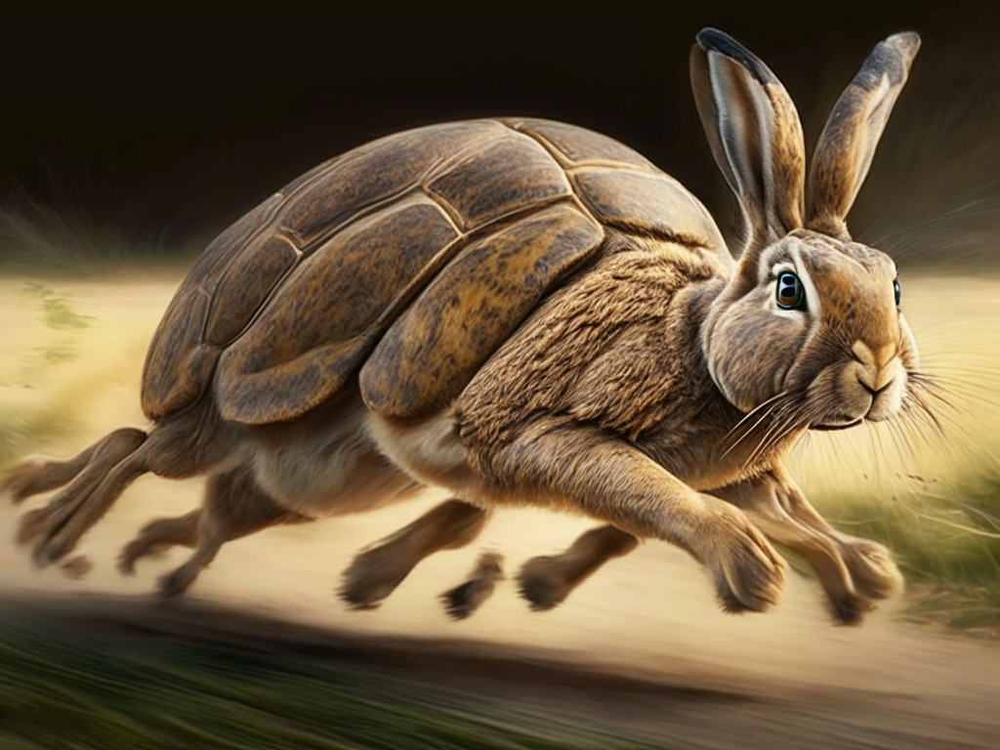

The Hare,A swift, energetic hare with soft fur and bright, eager eyes. sprinting ahead, the Tortoise,A steady, old tortoise with a hard shell and gentle eyes. moving steadily.


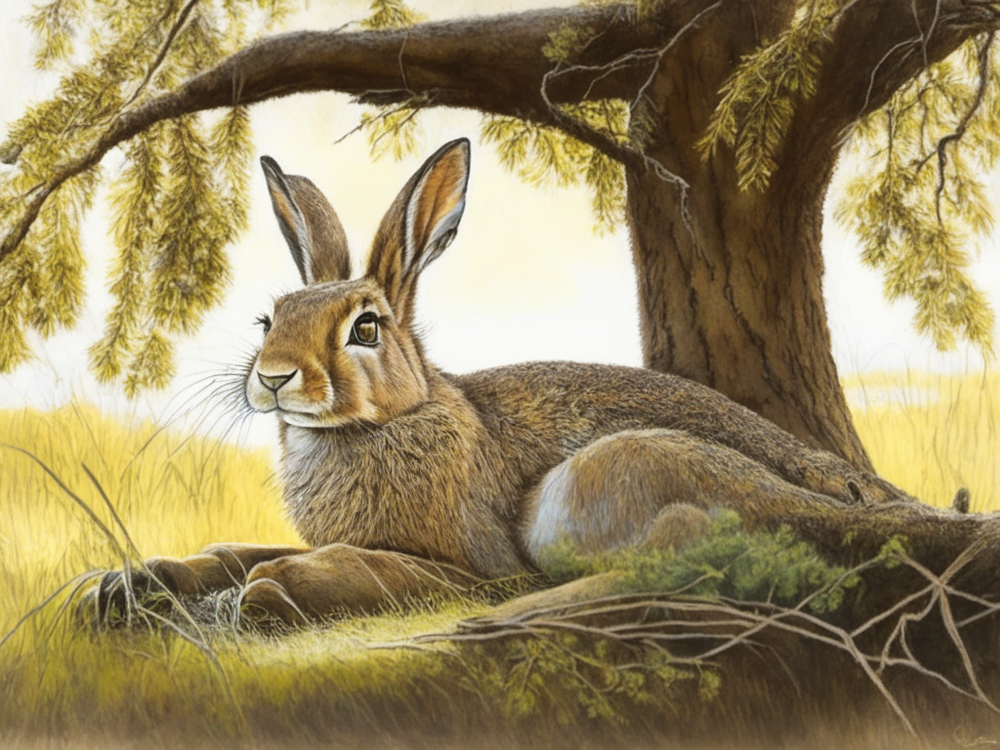

The Hare,A swift, energetic hare with soft fur and bright, eager eyes. resting under a tree, looking relaxed and confident.


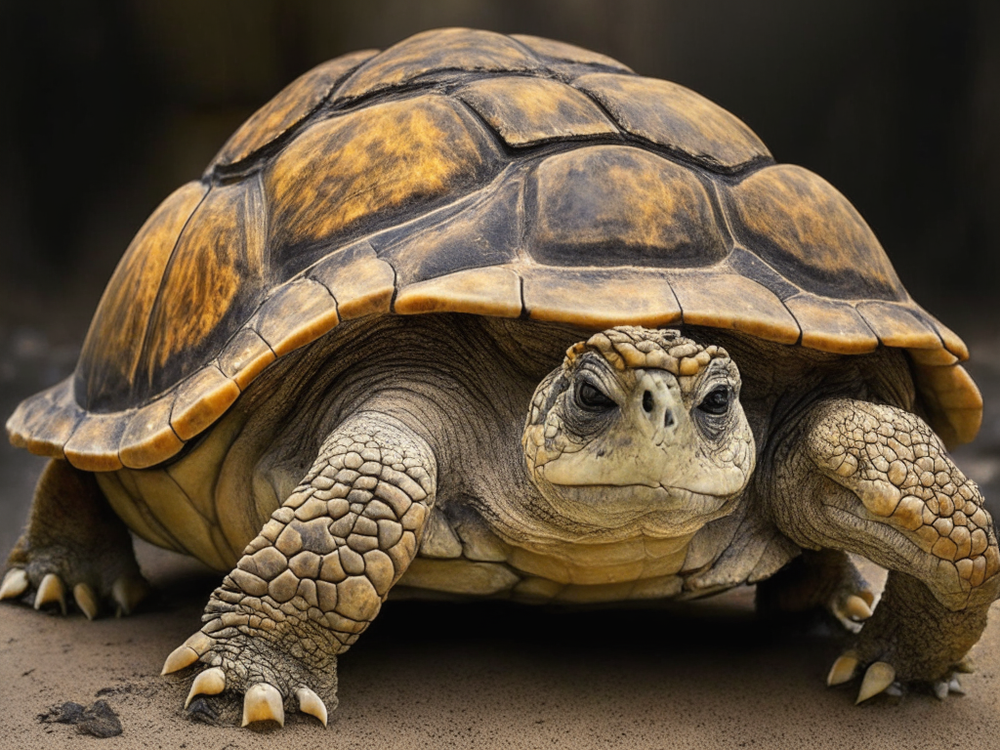

The Tortoise,A steady, old tortoise with a hard shell and gentle eyes. moving steadily, looking focused and determined.


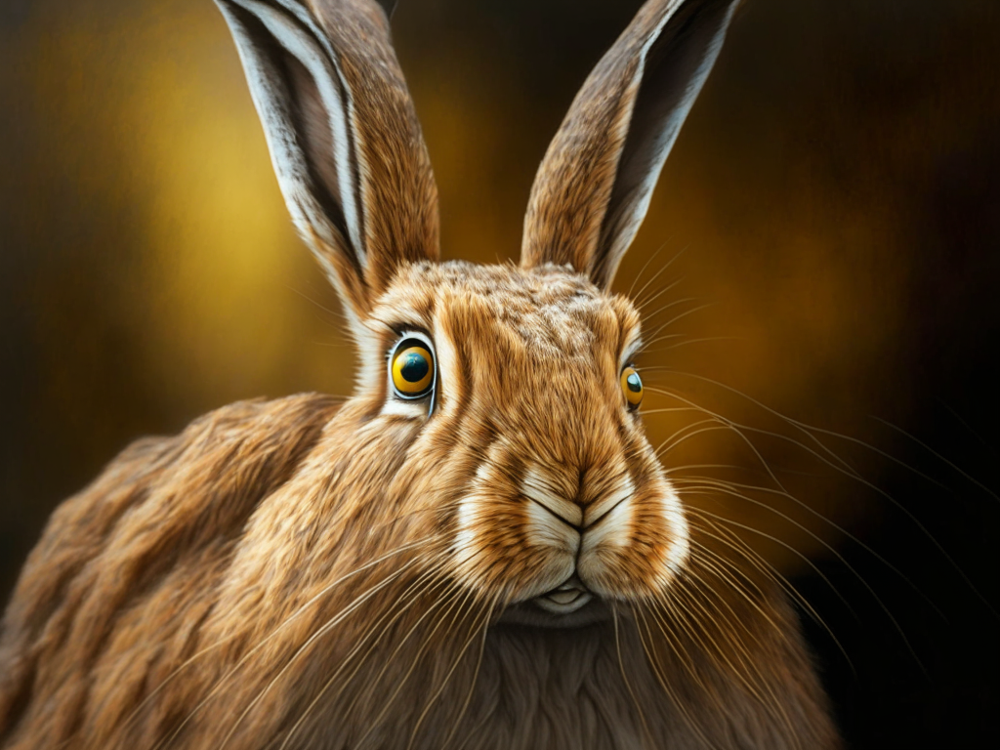

The Hare,A swift, energetic hare with soft fur and bright, eager eyes. waking up, looking surprised and worried.


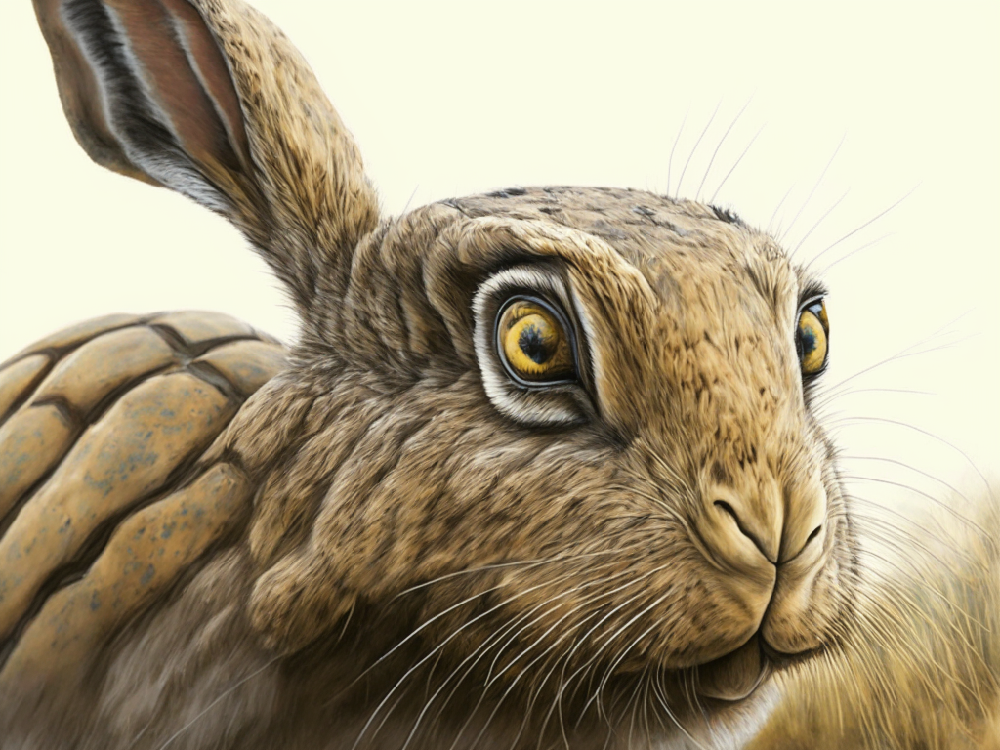

The Hare,A swift, energetic hare with soft fur and bright, eager eyes. looking shocked, the Tortoise,A steady, old tortoise with a hard shell and gentle eyes. nearing the finish line.


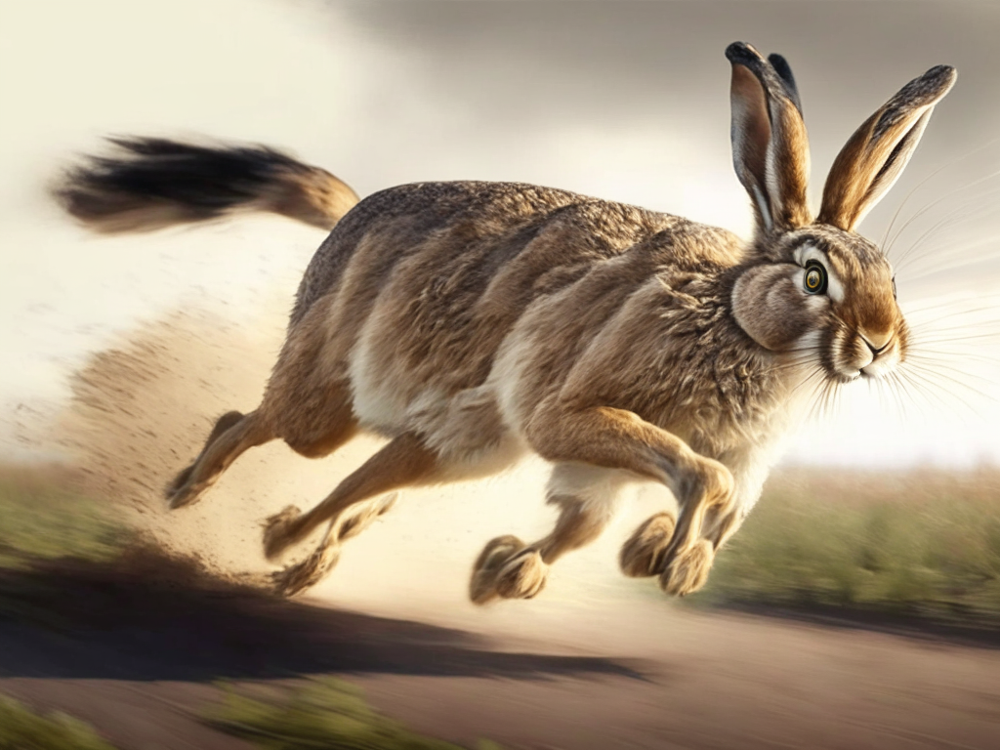

The Hare,A swift, energetic hare with soft fur and bright, eager eyes. sprinting towards the finish line, looking desperate.


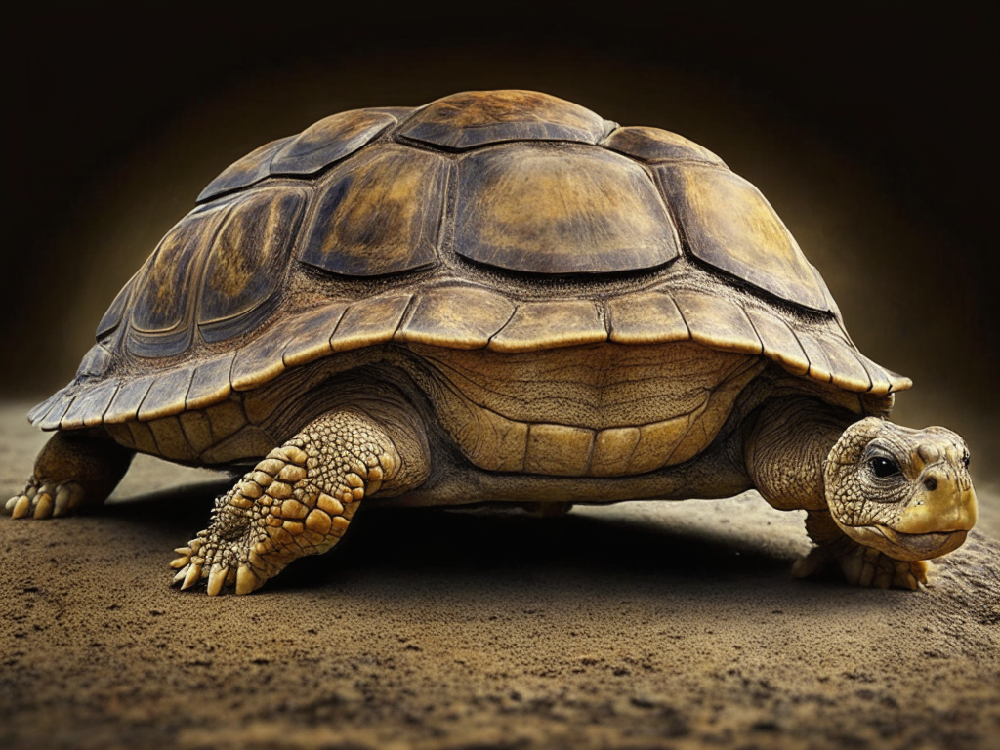

The Tortoise,A steady, old tortoise with a hard shell and gentle eyes. crossing the finish line, looking calm and victorious.


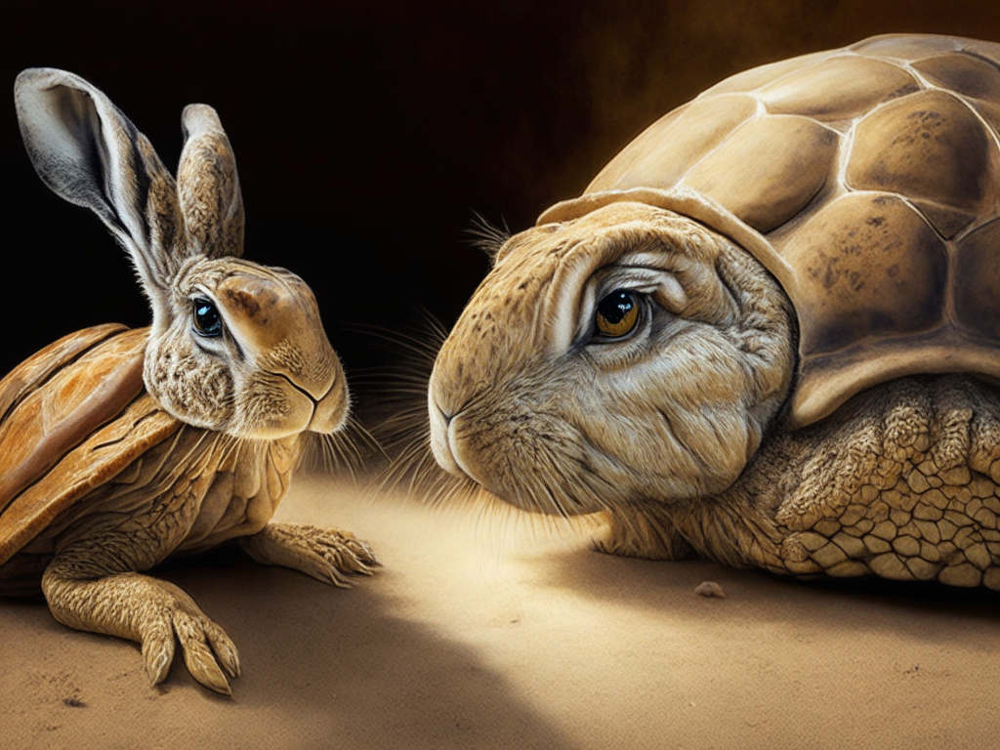

The Hare,A swift, energetic hare with soft fur and bright, eager eyes. apologizing to the Tortoise,A steady, old tortoise with a hard shell and gentle eyes., looking humble and regretful.


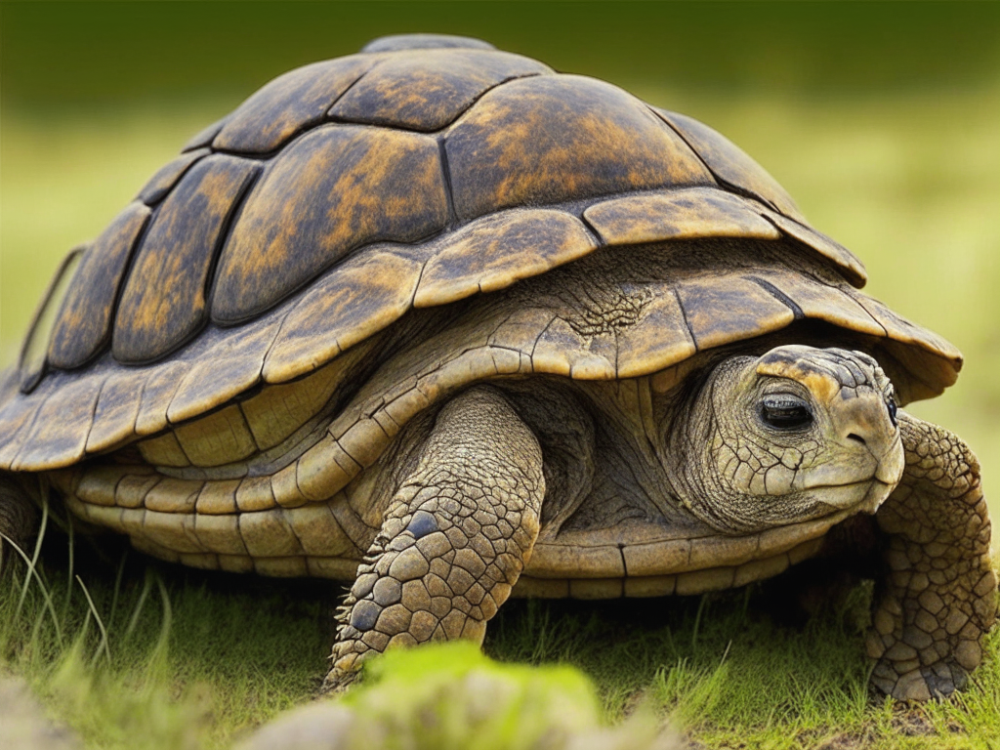

The Tortoise,A steady, old tortoise with a hard shell and gentle eyes. and the Hare,A swift, energetic hare with soft fur and bright, eager eyes. in the meadow, the Hare,A swift, energetic hare with soft fur and bright, eager eyes. looking humble, the Tortoise,A steady, old tortoise with a hard shell and gentle eyes. looking wise.


In [149]:
import requests
from PIL import Image
from io import BytesIO

video_urls = [v.output for v in video_predictions]
#audio_urls = [a.output['audio_out'] for a in audio_predictions]
music_url = chain_output['music_prediction'].output['audio']
subtitles = split_script
title_image_url = chain_output['title_image']
title_audio_url = chain_output['title_audio_prediction'].output['audio_out']

video_urls

for index, url in enumerate(video_urls):
    # Send a GET request to fetch the image content
    response = requests.get(url[0])

    # Read the image content from the response
    image = Image.open(BytesIO(response.content))

    # Display the image
    image.show()

    # Display the text
    print(script['story_lines'][index]['scene_description'])

In [144]:
from getpass import getpass

INPUT_TEXT = getpass()

··········


In [150]:

video_urls

[['https://replicate.delivery/pbxt/fGt1fH3Gr4nwDUQ6NBhBTmFoBzOZHuXjanSqVVz3JRvTyVORA/out_0.png'],
 ['https://replicate.delivery/pbxt/nYrxfPxMZr1LNaTwNhyA7eezCyugCQwsCkTUj4KLtHrmkrciA/out_0.png'],
 ['https://replicate.delivery/pbxt/5f5A9hM2aiTNKKgc3EksNolNDHPSQ4flMFkvkReU7deTJX5EB/out_0.png'],
 ['https://replicate.delivery/pbxt/KKMD00iPNSohGRsI5HtXffG4K6IwI6C6IJjvIRxhFwgcyVORA/out_0.png'],
 ['https://replicate.delivery/pbxt/x2Ie9aQDD8RdXSLp6HeqslP4GepVerLKZexnjdNgLcLCUuyJC/out_0.png'],
 ['https://replicate.delivery/pbxt/JSgfhpjxlq3xFCAH1qenEBNfWwcN9p5SbSSf3d0prfACUuyJC/out_0.png'],
 ['https://replicate.delivery/pbxt/fyCTe91SUMobeJY2CM25APT0ywLveT9qbgE1FdyGuVQIKX5EB/out_0.png'],
 ['https://replicate.delivery/pbxt/0dZxEVfWBUzsQiCy2rQPttHVI4BcTLHda89nzMwo4kVV5KnIA/out_0.png'],
 ['https://replicate.delivery/pbxt/p5kJgD8xB36LGZ3ukRCoDTrCeUkQR6fI7oxCQSvg7AgtyVORA/out_0.png'],
 ['https://replicate.delivery/pbxt/vkjNHJLZ5cbRCV7whRWg1mJc5tqFFbk5BPA2wAItioorclTE/out_0.png'],
 ['https://replicate.

In [146]:

page = 1
page_size = 100

# response = Resemble.v2.voices.all(page, page_size)
# voice = list(filter(lambda x: x['name'] == 'Jagan', response['items']))[0]

# response = Resemble.v2.projects.all(page, page_size)
# projects = response['items']

# response = Resemble.v2.clips.all(project_uuid, page, page_size)
# clips = response['items']

# create a new clip

audio_descriptions = script['story_lines']
print(audio_descriptions)

audio_clips = []
for i, story_line in enumerate(audio_descriptions):
    print(f"Creating audio prediction for {story_line['paragraphs']}")
    project_uuid = '2a577ebf'
    voice_uuid = 'f0426afb' #'fa25749e'
    callback_uri = 'https://example.com/callback/resemble-clip'
    body = story_line['paragraphs']
    print(body)
    response = Resemble.v2.clips.create_async(
        project_uuid,
        voice_uuid,
        callback_uri,
        body,
        title=f"My clip {i}",
        sample_rate=None,
        output_format=None,
        precision=None,
        include_timestamps=None,
        is_public=False,
        is_archived=False
    )

    audio_clips.append(response)


[{'paragraphs': 'In a lush green meadow, a steady Tortoise lived peacefully.', 'scene_description': 'A lush green meadow with a Tortoise,A steady, old tortoise with a hard shell and gentle eyes. slowly moving.', 'character_descriptions': [{'name': 'Tortoise', 'description': 'A steady, old tortoise with a hard shell and gentle eyes.'}]}, {'paragraphs': 'Nearby, a swift Hare, known for his speed, resided.', 'scene_description': 'A swift Hare,A swift, energetic hare with soft fur and bright, eager eyes. hopping around energetically in the meadow.', 'character_descriptions': [{'name': 'Hare', 'description': 'A swift, energetic hare with soft fur and bright, eager eyes.'}]}, {'paragraphs': 'The Hare often mocked the Tortoise for his slow pace.', 'scene_description': 'The Hare,A swift, energetic hare with soft fur and bright, eager eyes. teasing the Tortoise,A steady, old tortoise with a hard shell and gentle eyes., looking playful and a bit arrogant.', 'character_descriptions': []}, {'parag

In [147]:
end_text ='''Please like and subscribe for more such beautiful stories'''

print(f"Creating audio prediction for end_text")
project_uuid = '2a577ebf'
voice_uuid = 'f0426afb' #'fa25749e'
callback_uri = 'https://example.com/callback/resemble-clip'
body = end_text
print(body)
response = Resemble.v2.clips.create_async(
    project_uuid,
    voice_uuid,
    callback_uri,
    body,
    title=f"My clip {i}",
    sample_rate=None,
    output_format=None,
    precision=None,
    include_timestamps=None,
    is_public=False,
    is_archived=False
)
audio_clips.append(response)

Creating audio prediction for end_text
Please like and subscribe for more such beautiful stories


In [151]:
done = False
audio_urls = []
while not done:
  done = True
  for clip in audio_clips:
    response = Resemble.v2.clips.get(project_uuid, clip['item']['uuid'])
    time.sleep(5)
    if(response['success'] == True):
      print(response['item']['audio_src'])
      audio_urls.append(response['item']['audio_src'])
    else:
      done = False

  output.clear()

print("All audio clips are processed")

audio_urls

All audio clips are processed


['https://app.resemble.ai/rails/active_storage/blobs/redirect/eyJfcmFpbHMiOnsibWVzc2FnZSI6IkJBaHBCR0RCSEEwPSIsImV4cCI6bnVsbCwicHVyIjoiYmxvYl9pZCJ9fQ==--f5049e78babbb7f441e5c6bd48665f5468381e68/My+clip+0-c513c19f.wav',
 'https://app.resemble.ai/rails/active_storage/blobs/redirect/eyJfcmFpbHMiOnsibWVzc2FnZSI6IkJBaHBCRjNCSEEwPSIsImV4cCI6bnVsbCwicHVyIjoiYmxvYl9pZCJ9fQ==--48600da49d41db29e7e9ce32ab95597cd2aa655d/My+clip+1-df6755e4.wav',
 'https://app.resemble.ai/rails/active_storage/blobs/redirect/eyJfcmFpbHMiOnsibWVzc2FnZSI6IkJBaHBCRmJCSEEwPSIsImV4cCI6bnVsbCwicHVyIjoiYmxvYl9pZCJ9fQ==--61442d53012906d18f1f49068fe4cbabb6bc9338/My+clip+2-50f24476.wav',
 'https://app.resemble.ai/rails/active_storage/blobs/redirect/eyJfcmFpbHMiOnsibWVzc2FnZSI6IkJBaHBCR0xCSEEwPSIsImV4cCI6bnVsbCwicHVyIjoiYmxvYl9pZCJ9fQ==--54a79dc39ea46901a239db311a11ec2b21e32566/My+clip+3-be81b173.wav',
 'https://app.resemble.ai/rails/active_storage/blobs/redirect/eyJfcmFpbHMiOnsibWVzc2FnZSI6IkJBaHBCRjdCSEEwPSIsImV4cCI6bnVsbCwicH

In [157]:
## slow down the audio urls

import requests
import os

def slow_down_audio(input_file, output_file, slowdown_factor):
    # Load the audio file
    audio = AudioSegment.from_wav(input_file)

    # Calculate the new length of the audio
    new_length = int(len(audio) / slowdown_factor)

    # Stretch the audio by duplicating frames
    slowed_audio = audio._spawn(audio.raw_data, overrides={
        "frame_rate": int(audio.frame_rate * slowdown_factor)
    })

    # Export the modified audio to a file
    slowed_audio.export(output_file, format="mp3")
    print("Slowdown complete. Output file:", output_file)

slowdown_factor = 0.8

In [153]:
audio_files = []

for i, url in enumerate(audio_urls):
    response = requests.get(url)
    audio_filename = f"temp_audio{i}.wav"
    with open(audio_filename, "wb") as audio_file:
        audio_file.write(response.content)

    # Generate the output file name
    output_file = os.path.join(audio_filename.replace(".wav", ".mp3"))

    # Call the slow_down_audio function
    slow_down_audio(audio_filename, output_file, slowdown_factor)

    # Append the output file name to the array
    audio_files.append(output_file)
    #audio_files.append(audio_filename)

Slowdown complete. Output file: temp_audio0.mp3
Slowdown complete. Output file: temp_audio1.mp3
Slowdown complete. Output file: temp_audio2.mp3
Slowdown complete. Output file: temp_audio3.mp3
Slowdown complete. Output file: temp_audio4.mp3
Slowdown complete. Output file: temp_audio5.mp3
Slowdown complete. Output file: temp_audio6.mp3
Slowdown complete. Output file: temp_audio7.mp3
Slowdown complete. Output file: temp_audio8.mp3
Slowdown complete. Output file: temp_audio9.mp3
Slowdown complete. Output file: temp_audio10.mp3
Slowdown complete. Output file: temp_audio11.mp3
Slowdown complete. Output file: temp_audio12.mp3
Slowdown complete. Output file: temp_audio13.mp3
Slowdown complete. Output file: temp_audio14.mp3
Slowdown complete. Output file: temp_audio15.mp3


In [161]:
from moviepy.editor import *

def animate_image(image_url, output_file):
  # Download the image
  image = ImageClip(image_url, duration=10)

  # Get the initial size of the image
  initial_size = image.size

  # Define the zoom effect function
  # time "t" varies from 0 to 10, zoom starts from 1 and goes to 1.5 and then back to 1
  def zoom_effect(t):
      zoom_level = 1 + 0.2 * (1 - abs(t - 5) / 5)
      return [int(s * zoom_level) for s in initial_size]

  # Apply the zoom effect
  final_clip = CompositeVideoClip([image.set_position("center").resize(lambda t: zoom_effect(t))])

  # Save as MP4
  final_clip.write_videofile(output_file, fps=24)

In [162]:
import requests
import os
import moviepy.editor as mp
import moviepy.video.fx.all as vfx
import textwrap
from moviepy.editor import *
from PIL import Image, ImageDraw, ImageFont
from io import BytesIO
import numpy as np


# Download video and audio files
video_files = []
audio_files = []
# for i, url in enumerate(video_urls):
#     response = requests.get(url)
#     video_filename = f"temp_video{i}.mp4"
#     with open(video_filename, "wb") as video_file:
#         video_file.write(response.content)
#     video_files.append(video_filename)
fps = 12.0
for i, url in enumerate(video_urls):
    response = requests.get(url[0])
    image = Image.open(BytesIO(response.content))
    image_np = np.array(image)
    clip = mp.ImageSequenceClip([image_np], fps=fps)
    video_filename = f"temp_video{i}.mp4"
    # animate_image(url[0],video_filename)

    clip.write_videofile(video_filename, codec='libx264', fps=fps)
    #with open(video_filename, "wb") as video_file:
        #video_file.write(response.content)
    video_files.append(video_filename)

for i, url in enumerate(audio_urls):
    response = requests.get(url)
    audio_filename = f"temp_audio{i}.wav"
    with open(audio_filename, "wb") as audio_file:
        audio_file.write(response.content)

    # Generate the output file name
    output_file = os.path.join(audio_filename.replace(".wav", ".mp3"))

    # Call the slow_down_audio function
    slow_down_audio(audio_filename, output_file, slowdown_factor)

    # Append the output file name to the array
    audio_files.append(output_file)
    #audio_files.append(audio_filename)

# Load and process video and audio files

processed_videos = []
for i, audio_file in enumerate(audio_files):
    try:
      video = mp.VideoFileClip(video_files[i])
    except IndexError:
      video = mp.VideoFileClip(video_files[i-1])
    #video = mp.VideoFileClip(video_files[i])
    audio = mp.AudioFileClip(audio_file)

    # Loop the video for the duration of the audio
    looped_video = mp.concatenate_videoclips([video] * int(audio.duration // video.duration + 1))

    # Set the audio of the video to the audio file
    video_with_audio = looped_video.set_audio(audio)
    processed_videos.append(video_with_audio)

# Concatenate all the processed videos
final_video = mp.concatenate_videoclips(processed_videos)

## The following adds the title image / narration to the video.
# Add this function to create the text image
def txt_image(img, txt, font_size, color):
    image = img.copy()
    draw = ImageDraw.Draw(image)
    draw.text((50, 50), txt, fill=(255, 255, 0))
    # font = ImageFont.load_default().font_variant(size=font_size)
    # draw.text((50, 50), txt, font=font, fill=color)
    return image

# Download and create the image clip
image_url = title_image_url
response = requests.get(image_url)
img = Image.open(BytesIO(response.content))

# Resize the image to match the video dimensions
img_resized = img.resize((1200, 900))

# Download the audio file
audio_url = chain_output['ending_quote_prediction'].output['audio_out']
response = requests.get(audio_url)
audio_filename = "temp_audio_ending.wav"
with open(audio_filename, "wb") as audio_file:
    audio_file.write(response.content)

# Generate the output file name
output_file = os.path.join(audio_filename.replace(".wav", ".mp3"))

# Call the slow_down_audio function
slow_down_audio(audio_filename, output_file, slowdown_factor)

# Create the audio clip
audio_ending = AudioFileClip(output_file)

# make title empty for now, couldn't figure out how to get it bigger
text = chain_output['title']
img_text = ImageClip(np.asarray(txt_image(img_resized, txt='text', font_size=72, color="white")), duration=4)

# Set the audio of the image clip to the audio file and trim it to the same duration
img_text_audio_ending = mp.concatenate_videoclips([img_text] * int(audio_ending.duration // img_text.duration + 1))
img_text_audio_ending = img_text.set_audio(audio_ending)

# Download the title page audio file
audio_url = chain_output['title_audio_prediction'].output['audio_out']
response = requests.get(audio_url)
with open("temp_audio_title.mp3", "wb") as audio_file:
    audio_file.write(response.content)

# Create the audio clip
audio_beginning = AudioFileClip("temp_audio_title.mp3")

# Set the audio of the image clip to the audio file and trim it to the same duration
img_text_audio_beginning = mp.concatenate_videoclips([img_text] * int(audio_beginning.duration // img_text.duration + 1))
img_text_audio_beginning = img_text.set_audio(audio_beginning)

# Concatenate the image clip with the processed videos
width, height = processed_videos[0].size
title_video = img_text_audio_beginning.resize((width, height))
ending_video = img_text_audio_ending.resize((width, height))

# processed_videos.insert(0, title_video)
# processed_videos.append(ending_video)

final_video = concatenate_videoclips(processed_videos)

# Download the background audio file
bg_audio_url = music_url
response = requests.get(bg_audio_url)
with open("temp_bg_audio.mp3", "wb") as audio_file:
    audio_file.write(response.content)

# Create the background audio clip
bg_audio = AudioFileClip("temp_bg_audio.mp3")

# Calculate the duration of the final video
video_duration = final_video.duration

# Loop the background audio to match the final video's duration
bg_audio_looped = bg_audio.fx(afx.audio_loop, duration=video_duration)
bg_audio_looped = bg_audio_looped.volumex(0.3)

# Overlay the background audio with the audio from the final video
final_audio = CompositeAudioClip([final_video.audio, bg_audio_looped])

# Set the audio of the final video to the combined audio
final_video_with_bg_audio = final_video.set_audio(final_audio)

# Save the final video
final_video_with_bg_audio.write_videofile(f"how_to.mp4", codec='libx264', audio_codec='aac')

# Clean up temporary files
for video_file, audio_file in zip(video_files, audio_files):
    os.remove(video_file)
for audio_file in audio_files:
    os.remove(audio_file)

Moviepy - Building video temp_video0.mp4.
Moviepy - Writing video temp_video0.mp4



Moviepy - Done !
Moviepy - video ready temp_video0.mp4
Moviepy - Building video temp_video0.mp4.
Moviepy - Writing video temp_video0.mp4



Moviepy - Done !
Moviepy - video ready temp_video0.mp4


Moviepy - Building video temp_video1.mp4.
Moviepy - Writing video temp_video1.mp4



Moviepy - Done !
Moviepy - video ready temp_video1.mp4
Moviepy - Building video temp_video1.mp4.
Moviepy - Writing video temp_video1.mp4



Moviepy - Done !
Moviepy - video ready temp_video1.mp4


Moviepy - Building video temp_video2.mp4.
Moviepy - Writing video temp_video2.mp4



Moviepy - Done !
Moviepy - video ready temp_video2.mp4
Moviepy - Building video temp_video2.mp4.
Moviepy - Writing video temp_video2.mp4



Moviepy - Done !
Moviepy - video ready temp_video2.mp4


Moviepy - Building video temp_video3.mp4.
Moviepy - Writing video temp_video3.mp4



Moviepy - Done !
Moviepy - video ready temp_video3.mp4
Moviepy - Building video temp_video3.mp4.
Moviepy - Writing video temp_video3.mp4



Moviepy - Done !
Moviepy - video ready temp_video3.mp4


Moviepy - Building video temp_video4.mp4.
Moviepy - Writing video temp_video4.mp4



Moviepy - Done !
Moviepy - video ready temp_video4.mp4
Moviepy - Building video temp_video4.mp4.
Moviepy - Writing video temp_video4.mp4



Moviepy - Done !
Moviepy - video ready temp_video4.mp4


Moviepy - Building video temp_video5.mp4.
Moviepy - Writing video temp_video5.mp4



Moviepy - Done !
Moviepy - video ready temp_video5.mp4
Moviepy - Building video temp_video5.mp4.
Moviepy - Writing video temp_video5.mp4



Moviepy - Done !
Moviepy - video ready temp_video5.mp4


Moviepy - Building video temp_video6.mp4.
Moviepy - Writing video temp_video6.mp4



Moviepy - Done !
Moviepy - video ready temp_video6.mp4
Moviepy - Building video temp_video6.mp4.
Moviepy - Writing video temp_video6.mp4



Moviepy - Done !
Moviepy - video ready temp_video6.mp4


Moviepy - Building video temp_video7.mp4.
Moviepy - Writing video temp_video7.mp4



Moviepy - Done !
Moviepy - video ready temp_video7.mp4
Moviepy - Building video temp_video7.mp4.
Moviepy - Writing video temp_video7.mp4



Moviepy - Done !
Moviepy - video ready temp_video7.mp4


Moviepy - Building video temp_video8.mp4.
Moviepy - Writing video temp_video8.mp4



Moviepy - Done !
Moviepy - video ready temp_video8.mp4
Moviepy - Building video temp_video8.mp4.
Moviepy - Writing video temp_video8.mp4



Moviepy - Done !
Moviepy - video ready temp_video8.mp4


Moviepy - Building video temp_video9.mp4.
Moviepy - Writing video temp_video9.mp4



Moviepy - Done !
Moviepy - video ready temp_video9.mp4
Moviepy - Building video temp_video9.mp4.
Moviepy - Writing video temp_video9.mp4



Moviepy - Done !
Moviepy - video ready temp_video9.mp4


Moviepy - Building video temp_video10.mp4.
Moviepy - Writing video temp_video10.mp4



Moviepy - Done !
Moviepy - video ready temp_video10.mp4
Moviepy - Building video temp_video10.mp4.
Moviepy - Writing video temp_video10.mp4



Moviepy - Done !
Moviepy - video ready temp_video10.mp4


Moviepy - Building video temp_video11.mp4.
Moviepy - Writing video temp_video11.mp4



Moviepy - Done !
Moviepy - video ready temp_video11.mp4
Moviepy - Building video temp_video11.mp4.
Moviepy - Writing video temp_video11.mp4



Moviepy - Done !
Moviepy - video ready temp_video11.mp4


Moviepy - Building video temp_video12.mp4.
Moviepy - Writing video temp_video12.mp4



Moviepy - Done !
Moviepy - video ready temp_video12.mp4
Moviepy - Building video temp_video12.mp4.
Moviepy - Writing video temp_video12.mp4



Moviepy - Done !
Moviepy - video ready temp_video12.mp4


Moviepy - Building video temp_video13.mp4.
Moviepy - Writing video temp_video13.mp4



Moviepy - Done !
Moviepy - video ready temp_video13.mp4
Moviepy - Building video temp_video13.mp4.
Moviepy - Writing video temp_video13.mp4



Moviepy - Done !
Moviepy - video ready temp_video13.mp4


Moviepy - Building video temp_video14.mp4.
Moviepy - Writing video temp_video14.mp4



Moviepy - Done !
Moviepy - video ready temp_video14.mp4
Moviepy - Building video temp_video14.mp4.
Moviepy - Writing video temp_video14.mp4



Moviepy - Done !
Moviepy - video ready temp_video14.mp4


Slowdown complete. Output file: temp_audio0.mp3
Slowdown complete. Output file: temp_audio1.mp3
Slowdown complete. Output file: temp_audio2.mp3
Slowdown complete. Output file: temp_audio3.mp3
Slowdown complete. Output file: temp_audio4.mp3
Slowdown complete. Output file: temp_audio5.mp3
Slowdown complete. Output file: temp_audio6.mp3
Slowdown complete. Output file: temp_audio7.mp3
Slowdown complete. Output file: temp_audio8.mp3
Slowdown complete. Output file: temp_audio9.mp3
Slowdown complete. Output file: temp_audio10.mp3
Slowdown complete. Output file: temp_audio11.mp3
Slowdown complete. Output file: temp_audio12.mp3
Slowdown complete. Output file: temp_audio13.mp3
Slowdown complete. Output file: temp_audio14.mp3
Slowdown complete. Output file: temp_audio15.mp3
Slowdown complete. Output file: temp_audio_ending.mp3
Moviepy - Building video how_to.mp4.
MoviePy - Writing audio in how_toTEMP_MPY_wvf_snd.mp4


MoviePy - Done.
Moviepy - Writing video how_to.mp4



Moviepy - Done !
Moviepy - video ready how_to.mp4


In [163]:
#@title Watch the video
from IPython.display import HTML
from base64 import b64encode
mp4 = open(f'how_to.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [160]:
chain_output['ending_quote_prediction'].output['audio_out']

'https://replicate.delivery/pbxt/3oPJx0PUAmaQOxjrDWeeULZeeQ9cPSBJ48VfIc4D09PAXuyJC/audio.wav'